### Advanced Lane Finding Project




#### Camera Calibration and Undistortion

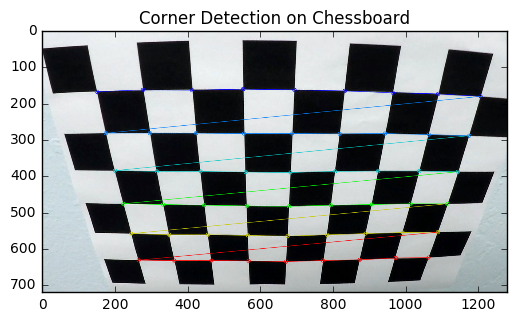

In [1]:
# LOAD FILES FOR CAMERA CALIBRATION FROM THE CHESSBOARD IMAGES AND PERFORM CORNER DETECTION VIA OPENCV
# Import Modules
import os
import pickle
import math
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from scipy.signal import find_peaks_cwt
%matplotlib inline

# Load Chessboard Image Directory
os.chdir('..')
OS=str(os.getcwd())
os.chdir(OS+'/Camera-Calibration-Images')

# Load Chessboard Images
Filename='calibration2.jpg'
Image=cv2.imread(Filename)

# Prepare Object Points
Nx=9 # The number of inside corners along X-Axis
Ny=6 # The number of inside corners in Y-Axis

# Convert to Grayscale
Gray=cv2.cvtColor(Image,cv2.COLOR_BGR2GRAY)

# Find the Chessboard Corners using OpenCV
ChessboardFlag,Corners=cv2.findChessboardCorners(Gray,(Nx,Ny),None)

# Arrays to Store Object Points and Image Points
ObjPoints = [] # 3D Points in Real World Space
ImgPoints = [] # 2D Points in Image Plane
    
# Prepare Object Points    
ObjP=np.zeros((Nx*Ny,3),np.float32)
ObjP[:,:2]=np.mgrid[0:Nx,0:Ny].T.reshape(-1,2)

# Draw Corners & Save Object Points and Image Points in Arrays
if ChessboardFlag==True:
    DummyImage=Image.copy()
    cv2.drawChessboardCorners(DummyImage,(Nx,Ny),Corners,ChessboardFlag)
    plt.imshow(DummyImage)
    plt.title('Corner Detection on Chessboard')
    plt.show()
    ObjPoints.append(ObjP)
    ImgPoints.append(Corners)

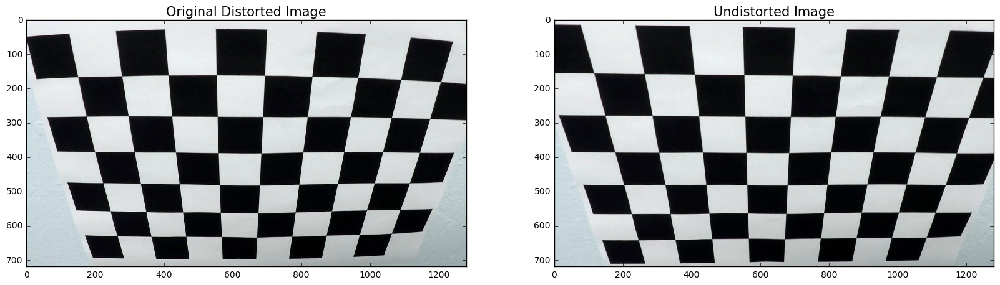

In [2]:
# PERFORM CAMERA CALIBRATION AND UNDISTORT IMAGE
# Camera Calibration via OpenCV
CalibrateFlag,CameraMat,DistCoeffs,RVecs,TVecs=cv2.calibrateCamera(ObjPoints,ImgPoints,
                                                                   (Image.shape[1],Image.shape[0]),None,None)

# Undistort Image via OpenCV
UndistImg=cv2.undistort(Image,CameraMat,DistCoeffs,None,CameraMat)
os.chdir('..')
cv2.imwrite('Camera-Calibration-Undistorted-Images/Undistorted2.jpg',UndistImg)

# Save the Camera Calibration Result
DistPickle={}
DistPickle["CameraMat"]=CameraMat
DistPickle["DistCoeffs"]=DistCoeffs
pickle.dump(DistPickle,open('Python-Files/DistPickle.p','wb'))

# Visualize Undistortion
Fig,(Axis1,Axis2)=plt.subplots(1,2,figsize=(20,10))
plt.title('Chessboard Image before and after Undistortion')
Axis1.imshow(Image)
Axis1.set_title('Original Distorted Image',fontsize=15)
Axis2.imshow(UndistImg)
Axis2.set_title('Undistorted Image',fontsize=15)

# Compute Reprojection Error
MeanProjectError=0
TotalProjectError=0
for i in range(len(ObjPoints)):
    ImgPointsProject,_=cv2.projectPoints(ObjPoints[i],RVecs[i],TVecs[i],CameraMat,DistCoeffs)
    ProjectError=cv2.norm(ImgPoints[i],ImgPointsProject,cv2.NORM_L2)/len(ImgPointsProject)
    TotalProjectError+=ProjectError
MeanProjectError=TotalProjectError/len(ObjPoints)

#### Edge Detection

In [3]:
# FUNCTION FOR REGION OF INTEREST (ROI)
def ROI(Image,Vertices):       
    # Initialize the Mask
    Mask=np.zeros_like(Image)   
    if len(Image.shape)>2:
        ChannelCount=Image.shape[2]
        IgnoreMaskColor=(255,)*ChannelCount
    else:
        IgnoreMaskColor=255
        
    # Filling Pixels    
    cv2.fillPoly(Mask,Vertices,IgnoreMaskColor)
    
    # Returning the Masked Image
    MaskedImg=cv2.bitwise_and(Image,Mask)
    return MaskedImg

print("Function for ROI complete!")

Function for ROI complete!


In [4]:
# FUNCTION TO COMPUTE SOBEL MASK BASED ON ABSOLUTE VALUE OF X/Y DERIVATIVE
def SobelAbsThresh(Gray,Orient='x',SobelKernel=3,Thresh=(0,255)):
    # Apply x or y Sobel Gradient via OpenCV
    if Orient=='x':
        Sobel=cv2.Sobel(Gray,cv2.CV_64F,1,0,SobelKernel)
    elif Orient=='y':
        Sobel=cv2.Sobel(Gray,cv2.CV_64F,0,1,SobelKernel)
        
    # Take the Absolute Values
    Sobel=np.absolute(Sobel)
    
    # Rescale to 8 Bit Integer
    ScaledSobel=np.uint8(255*Sobel/np.max(Sobel))

    # Apply the Threshold
    SobelImg=np.zeros_like(ScaledSobel)
    SobelImg[(ScaledSobel>Thresh[0]) & (ScaledSobel<Thresh[1])]=1
    
    # Return the Output
    return SobelImg

print("Function for Sobel Egde Detection in X and Y Direction!")

Function for Sobel Egde Detection in X and Y Direction!


In [5]:
# FUNCTION TO COMPUTE SOBEL MASK BASED ON MAGNITUDE
def SobelMagThresh(Gray,SobelKernel=3,MagThresh=(0,255)):
    # Apply x and y Sobel Gradients via OpenCV
    SobelX=cv2.Sobel(Gray,cv2.CV_64F,1,0,SobelKernel)
    SobelY=cv2.Sobel(Gray,cv2.CV_64F,0,1,SobelKernel)
    
    # Calculate the Gradient Magnitude
    Sobel=np.sqrt(SobelX**2+SobelY**2)
    
    # Rescale back to 8 bit integer
    ScaledSobel=np.uint8(255*Sobel/np.max(Sobel))
    
    # Create a copy and apply the threshold
    SobelImg=np.zeros_like(ScaledSobel)
    SobelImg[(ScaledSobel>MagThresh[0]) & (ScaledSobel<MagThresh[1])]=1
    
    # Return the result
    return SobelImg

print("Function for Sobel Operator!")

Function for Sobel Operator!


In [6]:
# FUNCTION TO COMPUTE SOBEL MASK BASED ON GRADIENT DIRECTION 
def SobelGradThresh(Gray,SobelKernel=3,Thresh=(0,np.pi/2)):
    # Apply X and Y Sobel Gradients via OpenCV
    SobelX=cv2.Sobel(Gray,cv2.CV_64F,1,0,SobelKernel)
    SobelY=cv2.Sobel(Gray,cv2.CV_64F,0,1,SobelKernel)
    
    # Error Statement to Ignore Errors
    with np.errstate(divide='ignore',invalid='ignore'):
        AbsGradient=np.absolute(np.arctan(SobelY/SobelX))
        SobelGradImg=np.zeros_like(AbsGradient)
        SobelGradImg[(AbsGradient>Thresh[0]) & (AbsGradient<Thresh[1])]=1
        
    # Return the Result
    return SobelGradImg

print("Function for Sobel Operator Direction!")

Function for Sobel Operator Direction!


In [7]:
# FUNCTION TO COMPUTE SATURATION MASK
def SaturationThresh(Saturation,Thresh=(0,255)):
    # Apply Saturation Mask 
    BinarySat=np.zeros_like(Saturation)
    BinarySat[(Saturation>Thresh[0]) & (Saturation<Thresh[1])]=1
    
    # Return the Result
    return BinarySat

print("Function for Saturation Mask!")

Function for Saturation Mask!


In [8]:
# FUNCTION TO COMPUTE HUE MASK
def HueThresh(Hue,Thresh=(0,255)):
    # Apply Hue Mask 
    BinaryHue=np.zeros_like(Hue)
    BinaryHue[(Hue>Thresh[0]) & (Hue<Thresh[1])]=1
    
    # Return the Result
    return BinaryHue

print("Function for Hue Mask!")

Function for Hue Mask!


In [9]:
# FUNCTION FOR EDGE DETECTION
def EdgeDetection(Image):         
    # Define Gaussian Blur Kernel Size
    GaussianKernelSize=5
    
    # Gaussian Blur via OpenCV
    Image=cv2.GaussianBlur(Image,(GaussianKernelSize,GaussianKernelSize),0)
    
    # Convert to Grayscale Image
    Gray=cv2.cvtColor(Image,cv2.COLOR_RGB2GRAY)
    
    # Define Sobel Kernel Size
    SobelKernelSize=7
    
    # Apply All Sobel Thresholding Functions
    BinarySobelX=SobelAbsThresh(Gray,Orient='x',SobelKernel=SobelKernelSize,Thresh=(10,255))
    BinarySobelY=SobelAbsThresh(Gray,Orient='y',SobelKernel=SobelKernelSize,Thresh=(60,255))
    BinarySobelMag=SobelMagThresh(Gray,SobelKernel=SobelKernelSize,MagThresh=(40,255))
    BinarySobelDir=SobelGradThresh(Gray,SobelKernel=SobelKernelSize,Thresh=(0.65,1.05))
    
    # Combine All Thresholds
    CombinedSobel=np.zeros_like(BinarySobelDir)
    CombinedSobel[((BinarySobelX==1) & (BinarySobelY==1)) | ((BinarySobelMag==1) & (BinarySobelDir==1))]=1
    
    # Convert to HLS Color Space
    HLS=cv2.cvtColor(Image,cv2.COLOR_RGB2HLS)
    Hue=HLS[:,:,0]
    Saturation=HLS[:,:,2]
    
    # Threshold Saturation Channel
    BinarySat=SaturationThresh(Saturation,Thresh=(160,255))
    
    # Threshold Hue Channel
    BinaryHue=HueThresh(Hue,Thresh=(20,50))
        
    # Stack each Channel to View their Individual Contributions in Green and Blue respectively
    # This returns a Stack of the Two Binary Images, whose Components you can see as Different Colors
    StackBinary=np.dstack((np.zeros_like(CombinedSobel),CombinedSobel,BinarySat))
    
    BinaryColor=np.zeros_like(CombinedSobel)
    BinaryColor[((BinarySat==1) | (BinaryHue==1)) | (CombinedSobel==1)]=1
    
    # Defining Vertices for ROI
    ImgShape=Image.shape
    LeftBottom1=(100,ImgShape[0])
    RightBottom1=(ImgShape[1]-100, ImgShape[0])
    LeftPeak1=(550,425)
    RightPeak1=(ImgShape[1]-550,425)
    LeftBottom2=(300,ImgShape[0])
    RightBottom2=(ImgShape[1]-300,ImgShape[0])
    LeftPeak2=(650,480)
    RightPeak2=(ImgShape[1]-650,480)
    Vertices=np.array([[LeftBottom1,LeftPeak1,RightPeak1,RightBottom1,RightBottom2,RightPeak2,LeftPeak2,LeftBottom2]],dtype=np.int32)
   
    # Masked Area
    ROIImage=ROI(Image,Vertices)
    BinaryColor=ROI(BinaryColor,Vertices)
    
    # Return Edge Detection Image
    return BinaryColor,StackBinary,ROIImage

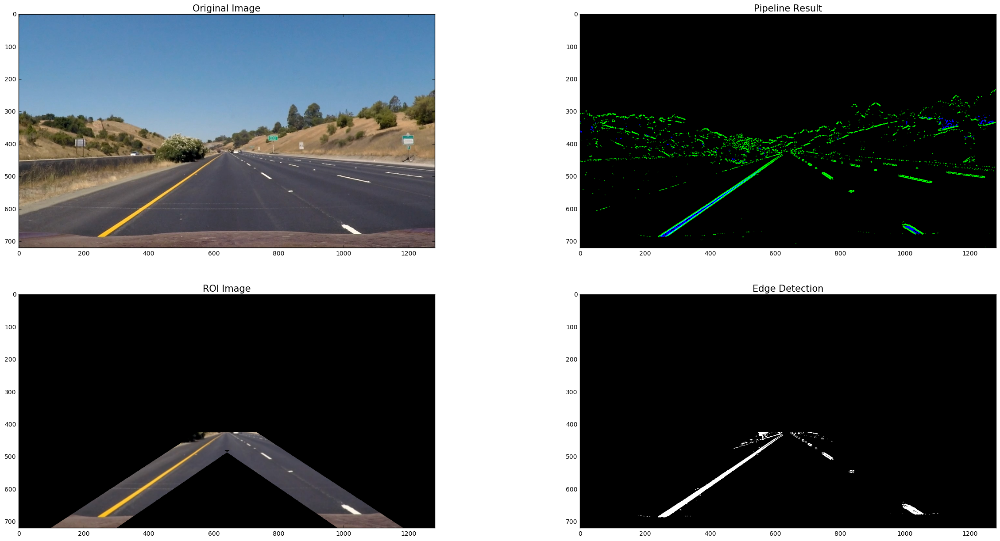

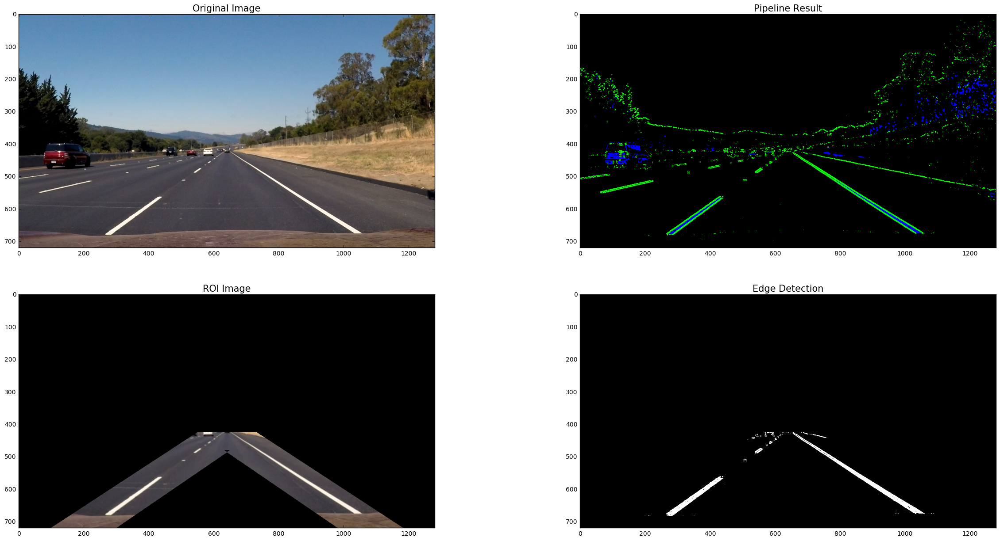

In [10]:
# PERFORM EDGE DETECTION ON STRAIGHT ROAD IMAGES
# Process Each Straight Line Image in Loop
for i in range(1,3):
    # Load Image
    Filename='Test-Images/straight_lines{}.jpg'.format(i)
    Image=plt.imread(Filename)
    
    # Process Image
    Result,StackBinary,ROIImage=EdgeDetection(Image)
    
    # Plot the Results
    Figure,((Axis0,Axis1),(Axis2,Axis3))=plt.subplots(2,2,figsize=(30,15))
    Axis0.imshow(Image)
    Axis0.set_title('Original Image',fontsize=15)
    Axis1.imshow(StackBinary)
    Axis1.set_title('Pipeline Result',fontsize=15)
    Axis2.imshow(ROIImage)
    Axis2.set_title('ROI Image',fontsize=15) 
    Axis3.imshow(Result,cmap='gray')
    Axis3.set_title('Edge Detection',fontsize=15) 

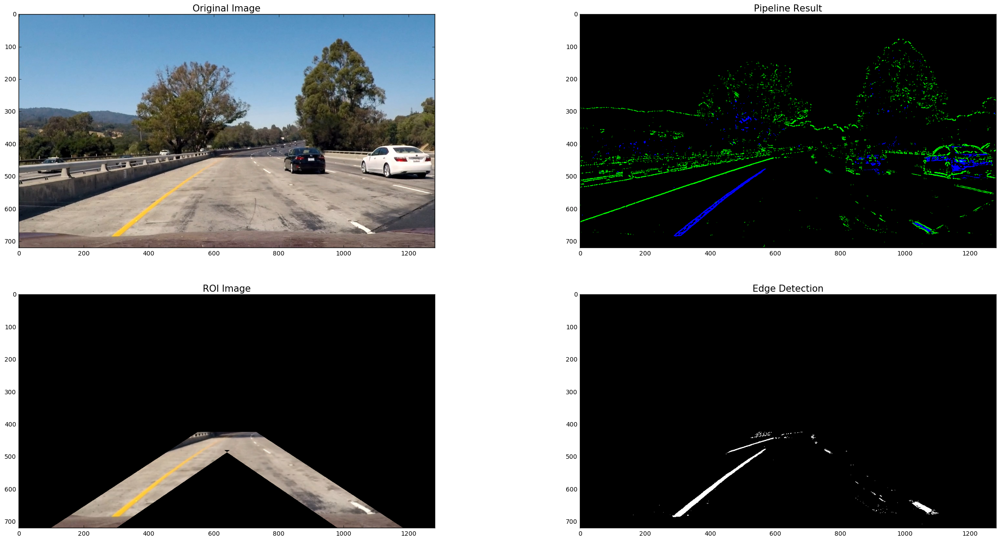

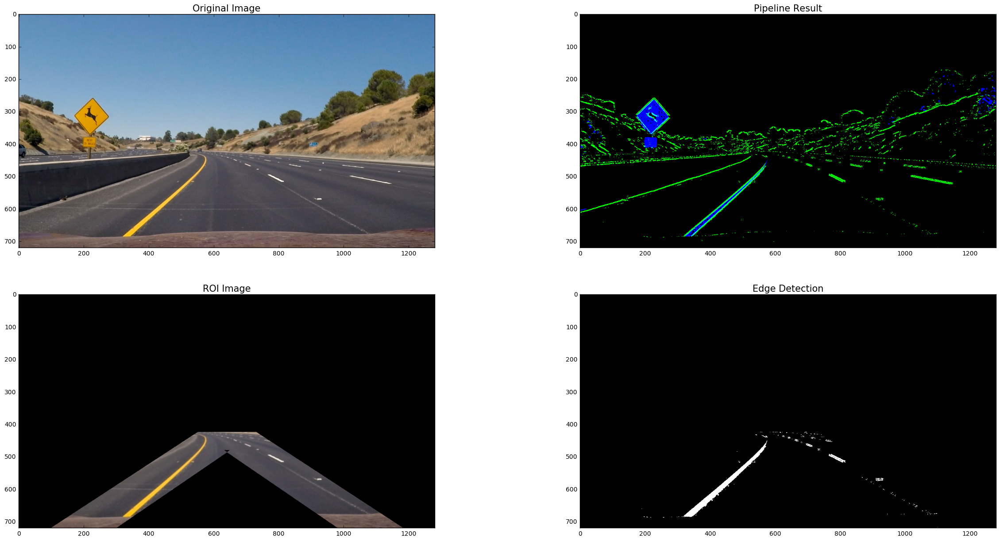

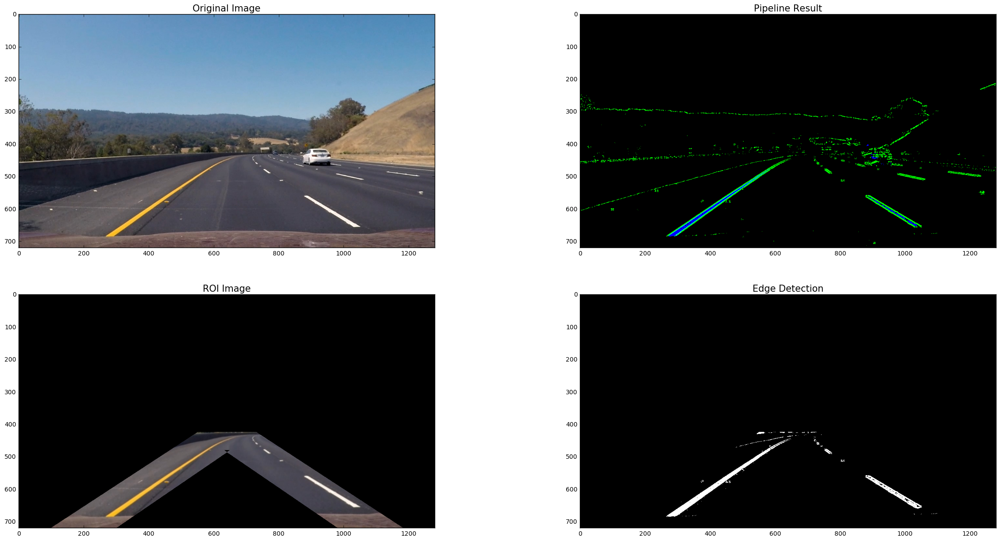

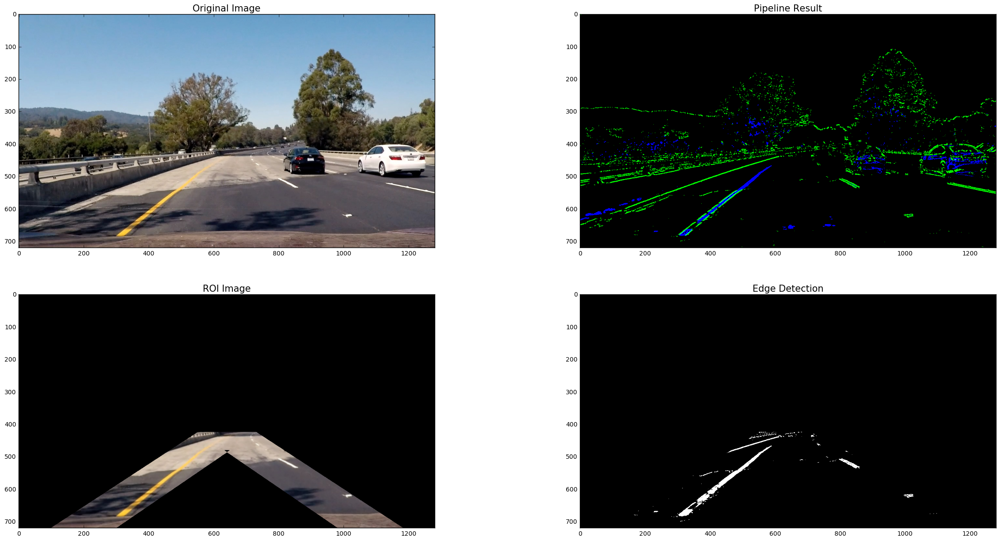

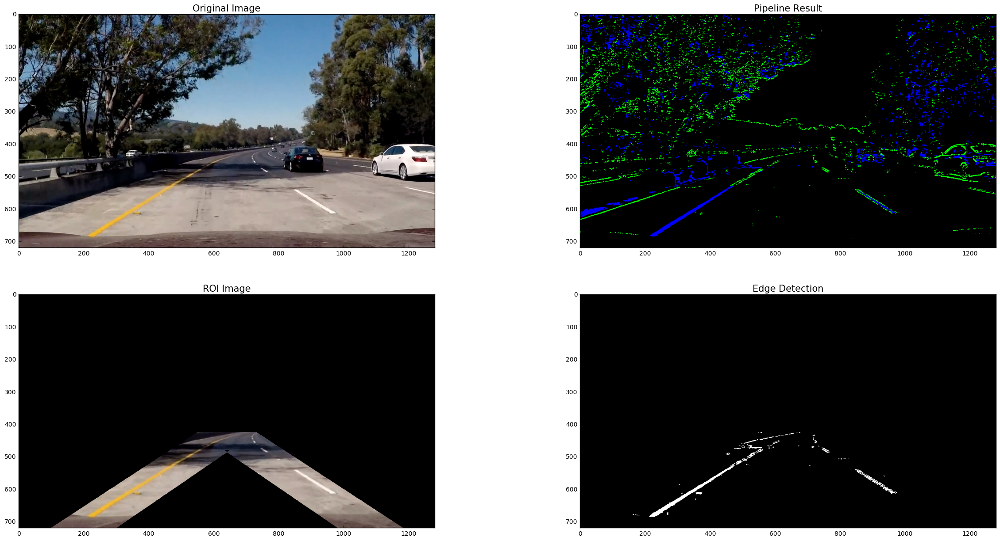

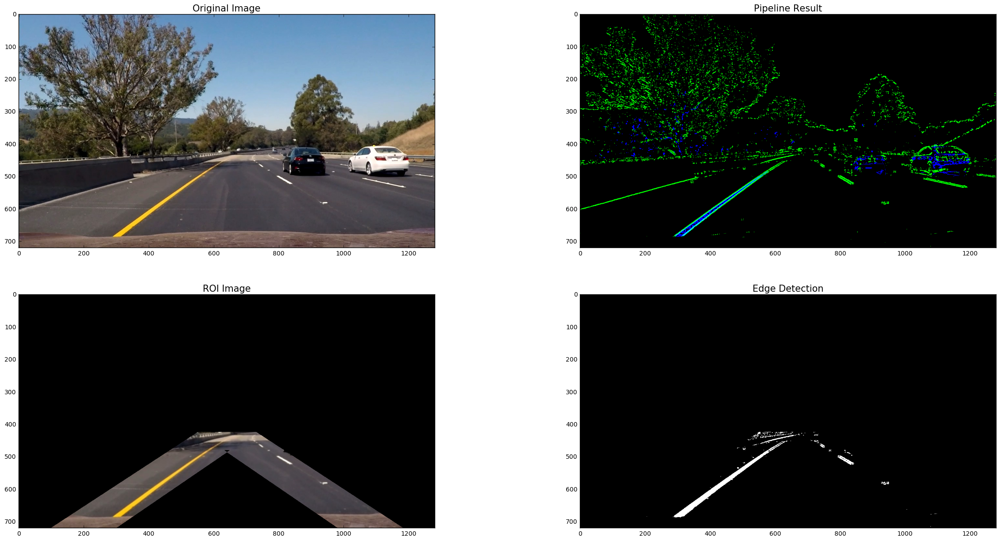

In [11]:
# PERFORM EDGE DETECTION ON IMAGES
# Process Each Test Image in Loop
for i in range(1,7):
    # Load Image
    Filename='Test-Images/test{}.jpg'.format(i)
    Image=plt.imread(Filename)
    
    # Process Image
    Result,StackBinary,ROIImage=EdgeDetection(Image)
    
    # Plot the Results
    Figure,((Axis0,Axis1),(Axis2,Axis3))=plt.subplots(2,2,figsize=(30,15))
    Axis0.imshow(Image)
    Axis0.set_title('Original Image',fontsize=15)
    Axis1.imshow(StackBinary)
    Axis1.set_title('Pipeline Result',fontsize=15)
    Axis2.imshow(ROIImage)
    Axis2.set_title('ROI Image',fontsize=15) 
    Axis3.imshow(Result,cmap='gray')
    Axis3.set_title('Edge Detection',fontsize=15) 

#### Perspective Transformation

In [12]:
# FUNCTION FOR PERSPECTIVE TRANSFORM
def BirdEyeView(Image,CameraMat,DistCoeffs):
    # Remove Distortion via OpenCV
    UndistortImg=cv2.undistort(Image,CameraMat,DistCoeffs,None,CameraMat)
    
    # Define the Vertices of Road from Original Image
    RoadVerticesOriginal=np.float32([[580,460],[700,460],[1080,720],[200,720]])
    
    # Define the Vertices of Road for Bird's Eye View Projection
    ImgShape=Image.shape
    RoadVerticesBirdEyeView=np.float32([[220,0],[ImgShape[1]-220,0],
                                        [ImgShape[1]-220,ImgShape[0]],[220,ImgShape[0]]])

    # Compute the Perspective Transformation Matrix via OpenCV
    WarpMat=cv2.getPerspectiveTransform(RoadVerticesOriginal,RoadVerticesBirdEyeView)
    WarpMatInv=cv2.getPerspectiveTransform(RoadVerticesBirdEyeView,RoadVerticesOriginal)
    
    # Warp the Image via OpenCV
    BirdViewImg=cv2.warpPerspective(UndistortImg,WarpMat,(ImgShape[1],ImgShape[0]))
    
    # Return the Bird Eye View Image and Matrix
    return BirdViewImg,WarpMat,WarpMatInv,RoadVerticesOriginal,RoadVerticesBirdEyeView

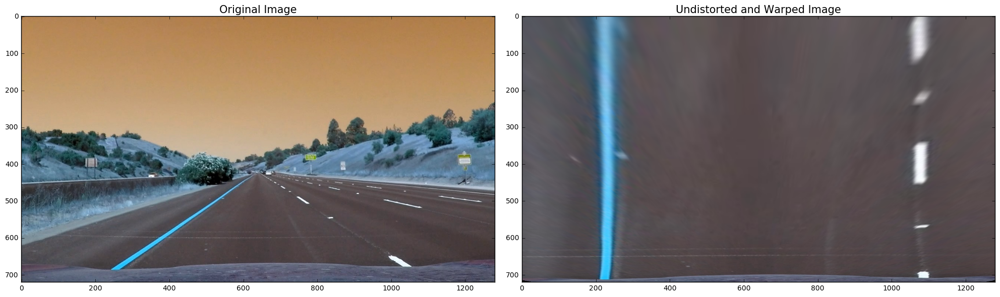

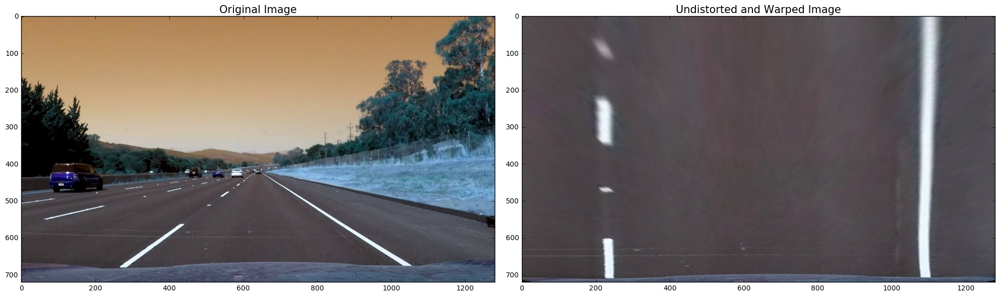

In [13]:
# PERFORM BIRD EYE VIEW TRANSFORMATION ON STRAIGHT ROAD IMAGES
# Warp Each Straight Line Image in Loop (Both Lines should appear Parallel)
for i in range(1,3):
    # Load Image
    Filename='Test-Images/straight_lines{}.jpg'.format(i)
    Image=cv2.imread(Filename)
    
    # Perform Bird View Projection
    BirdViewImg,WarpMat,WarpMatInv,VerticesOriginal,VerticesBirdEyeView=BirdEyeView(Image,CameraMat,DistCoeffs)
        
    # Plot the Results 
    Figure,(Axis1,Axis2)=plt.subplots(1,2,figsize=(20,10))
    Figure.tight_layout()
    Axis1.imshow(Image)
    Axis1.set_title('Original Image',fontsize=15)
    Axis2.imshow(BirdViewImg)
    Axis2.set_title('Undistorted and Warped Image',fontsize=15)

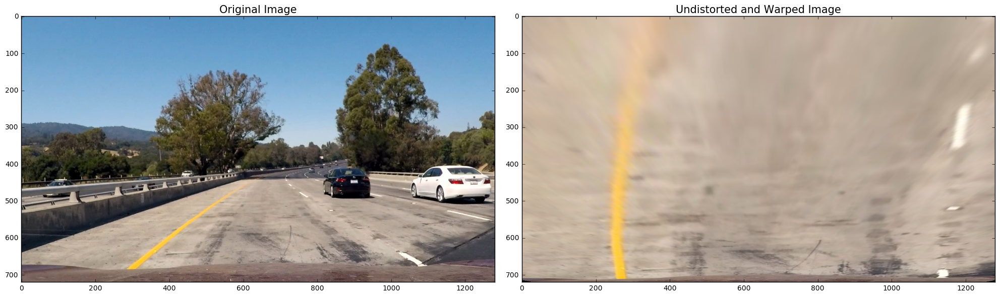

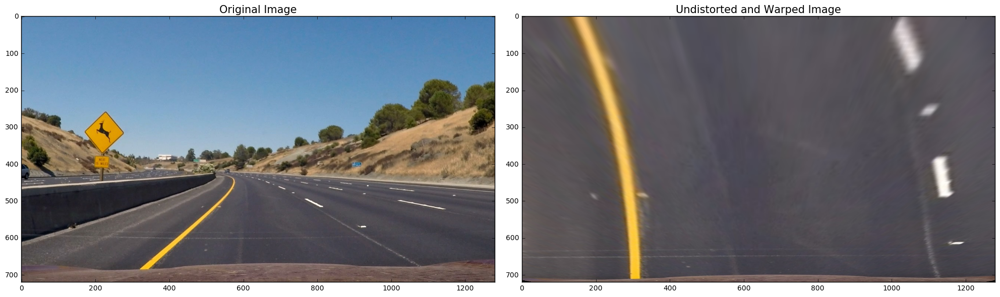

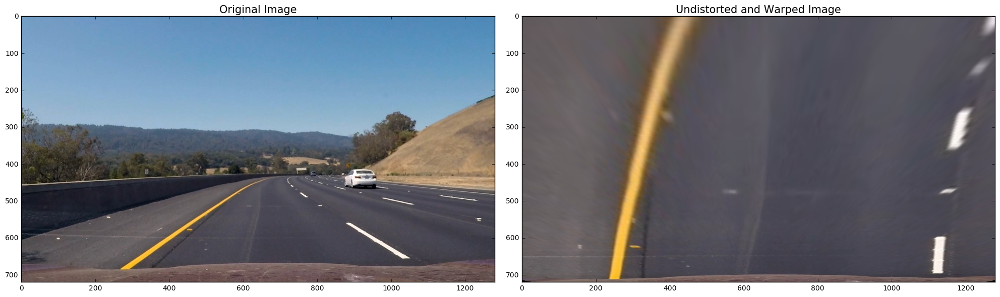

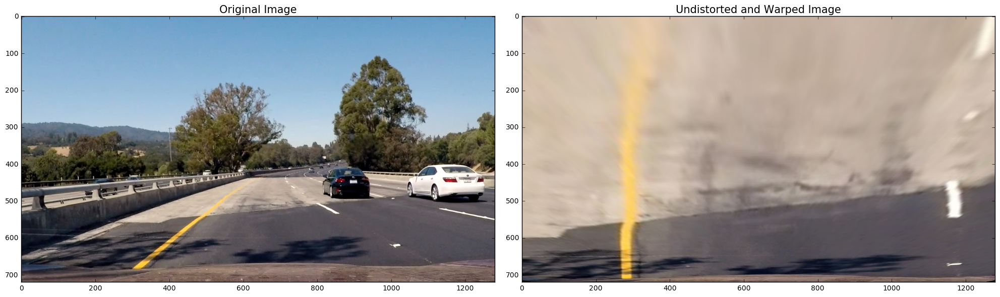

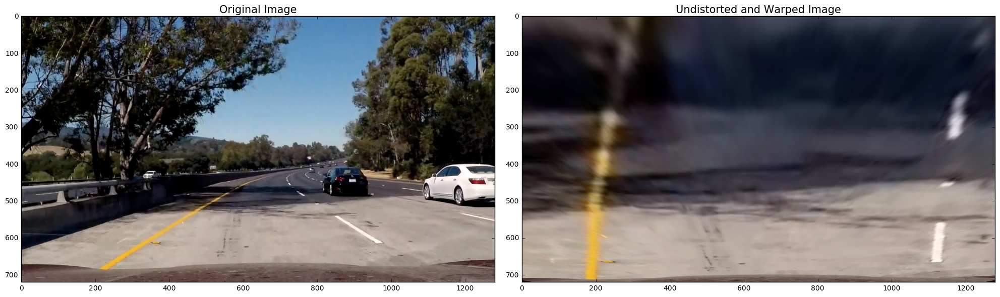

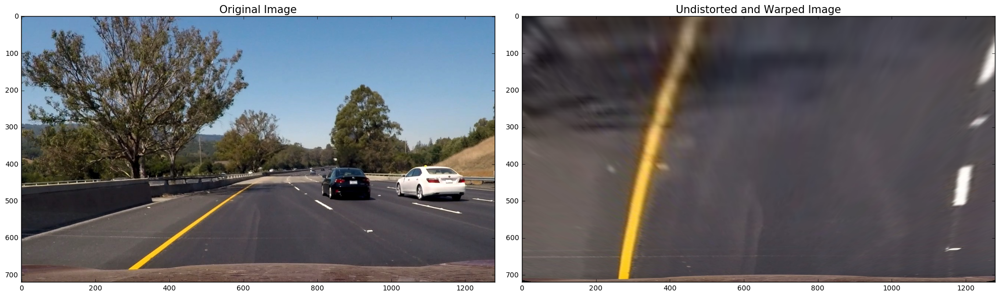

In [14]:
# PERFORM EDGE DETECTION ON IMAGES
# Warp Each Test Image in Loop
for i in range(1,7):
    # Load Image
    Filename='Test-Images/test{}.jpg'.format(i)
    Image=plt.imread(Filename)
    
    # Perform Bird View Projection
    BirdViewImg,WarpMat,WarpMatInv,VerticesOriginal,RoadVerticesBirdEyeView=BirdEyeView(Image,CameraMat,DistCoeffs)
    
    # Plot the Results 
    Figure,(Axis1,Axis2)=plt.subplots(1,2,figsize=(20,10))
    Figure.tight_layout()
    Axis1.imshow(Image)
    Axis1.set_title('Original Image',fontsize=15)
    Axis2.imshow(BirdViewImg)
    Axis2.set_title('Undistorted and Warped Image',fontsize=15)

#### Line Class & Misc Functions to Detect Lines

In [15]:
# DEFINE A LINE CLASS AS INSTRUCTED IN THE VIDEO LECTURES
class Line():
    def __init__(Self):
        # Boolean: Was the Line Detected in the Last Iteration?
        Self.Detected=False
        
        # X Values of the Last N Fits of the Line
        Self.RecentXFitted=[]
        
        # Average X Values of the Fitted Line Over the Last N Iterations
        Self.BestX=None
        
        # Polynomial Coefficients Averaged over the last N iterations
        Self.BestFit=None  
        
        # Polynomial Coefficients for the Most Recent Fit
        Self.CurrentFit=[np.array([False])]  
        
        # Radius of Curvature of the Line in Some Units
        Self.RadiusCurvature=None 
        
        # Distance in Meters of Vehicle Center from the Line
        Self.LineBasePos=None 
        
        # Difference in Fit Coefficients between Last and New Fits
        Self.Diffs=np.array([0,0,0],dtype='float') 
        
        # X Values for Detected Line Pixels
        Self.AllX=None  
        
        # Y Values for Detected Line Pixels
        Self.AllY=None
        
        # X Values in Windows
        Self.Windows=np.ones((4,12))*-1
        
print("Line Class!")

Line Class!


In [16]:
# DEFINE A FUNCTION FOR FINDING POSITION
def FindPosition(Pts):
    # Find the Position of the Car from the Center
    # It will show if the Car is X meters from the Left or Right
    Position=Image.shape[1]/2
    Left=np.min(Pts[(Pts[:,1]<Position) & (Pts[:,0]>700)][:,1])
    Right=np.max(Pts[(Pts[:,1]>Position) & (Pts[:,0]>700)][:,1])
    Center=(Left+Right)/2
    
    # Define Conversions in X and Y from Pixels to Meters
    MetersPerPix=3.7/700 # meteres per pixel in x dimension    
    return (Position-Center)*MetersPerPix

print("Find Position Function!")

Find Position Function!


In [17]:
# DEFINE A FUNCTION FOR FINDING CURVATURE AS SHOWN IN VIDEO LECTURES
def FindCurvature(YVals,FitX):
    # Define Y-Value where We Want Radius of Curvature
    # I'll Choose the Maximum Y-value, Corresponding to the Bottom of the Image
    YEval=np.max(YVals)
    
    # Define Conversions in X and Y from Pixels to Meters   
    XmPix=3.7/700 # Meteres per Pixel along X Axis (Taken from the Video Lectures)
    YmPix=30.0/720 # Meters per Pixel along Y Axis (Taken from the Video Lectures)
    
    # Compute Polyline Coefficients using Numpy
    FitCurve=np.polyfit(YVals*YmPix,FitX*XmPix,2)
    
    # Compute Radius of Curvature
    CurveRad=((1+(2*FitCurve[0]*YEval+FitCurve[1])**2)**1.5)/np.absolute(2*FitCurve[0])
    
    # Return Radius of Curvature
    return CurveRad

print("Find Curvature Function!")

Find Curvature Function!


In [18]:
# DEFINE A FUNCTION FOR FINDING PEAKS
def FindPeaks(Image,YWindowTop,YWindowBottom,XLeft,XRight):
    # Find the Historgram from the Image inside the Window
    Histogram=np.sum(Image[YWindowTop:YWindowBottom,:],axis=0)
    
    # Find the Peaks from the Histogram
    if len(Histogram[int(XLeft):int(XRight)])>0:
        return np.argmax(Histogram[int(XLeft):int(XRight)])+XLeft
    else:
        return (XLeft+XRight)/2  

print("Find Peaks Function!")

Find Peaks Function!


In [19]:
# DEFINE A FUNCTION FOR SANITY CHECK AS SHOWN IN VIDEO LECTURES
def SanityCheck(Lane,CurveRad,FitX,Fit):       
    # Sanity Check for the Lane
    if Lane.Detected: # If Lane is Detected
        # If Sanity Check Passes
        if abs(CurveRad/Lane.RadiusCurvature-1)<0.6:        
            Lane.Detected=True
            Lane.CurrentFit=Fit
            Lane.AllX=FitX
            Lane.BestX=np.mean(FitX)            
            Lane.RadiusCurvature=CurveRad
            Lane.CurrentFit=Fit
        # If Sanity Check Fails use the Previous Values
        else:
            Lane.Detected=False
            FitX=Lane.AllX
    else:
        # If Lane was not Detected and no Curvature is Defined
        if Lane.RadiusCurvature: 
            if abs(CurveRad/Lane.RadiusCurvature-1)<1:            
                Lane.Detected=True
                Lane.CurrentFit=Fit
                Lane.AllX=FitX
                Lane.BestX=np.mean(FitX)            
                Lane.RadiusCurvature=CurveRad
                Lane.CurrentFit=Fit
            else:
                Lane.Detected=False
                FitX=Lane.AllX      
        # If Curvature was Defined
        else:
            Lane.Detected=True
            Lane.CurrentFit=Fit
            Lane.AllX=FitX
            Lane.BestX=np.mean(FitX)
            Lane.RadiusCurvature=CurveRad
    return FitX

# Sanity Check for the Direction
def SanityCheckDirection(Right,RightPre,RightPre2):
    # Check whether the Direction is OK 
    if abs((Right-RightPre)/(RightPre-RightPre2)-1)<0.2:
        return Right
    
    # If not then Compute the Value from the Previous Values
    else:
        return RightPre+(RightPre-RightPre2)

print("Sanity Check Functions!")

Sanity Check Functions!


In [20]:
# DEFINE A FUNCTION TO DETECT LEFT & RIGHT LANES FROM THE BIRD'S EYE VIEW IMAGE
def FindLanes(N,Image,XWindow,Lanes,LeftLaneX,LeftLaneY,RightLaneX,RightLaneY,WindowInd):
    # 'N' Windows will be used to Identify Peaks of Histograms
    # Set 'XWindowRange'
    XWindowRange=np.zeros((N+1,2))
    XWindowRange[0]=[200,1080]
    XWindowRange[1]=[200,1080]
    
    # Set the First Left & Right Values
    Left,Right=(200,1080)
    
    # Set the Center
    Center=640
    
    # Set the Previous Center
    CenterPre=Center
    
    # Set the Direction
    Direction=0
    for i in range(N-1):
        # Set the Window Range.
        YWindowTop=720-720/N*(i+1)
        YWindowBottom=720-720/N*i
        
        # If Left and Right Lanes are Detected from the Previous Image
        if (LeftLane.Detected==False) and (RightLane.Detected==False):
            # Find the Historgram from the Image inside the Window
            Left=FindPeaks(Image,YWindowTop,YWindowBottom,XWindowRange[i+1,0]-200,XWindowRange[i+1,0]+200)
            Right=FindPeaks(Image,YWindowTop,YWindowBottom,XWindowRange[i+1,1]-200,XWindowRange[i+1,1]+200)
            
            # Set the Direction
            Left=SanityCheckDirection(Left,XWindowRange[i+1,0],XWindowRange[i,0])
            Right=SanityCheckDirection(Right,XWindowRange[i+1,1],XWindowRange[i,1])
            
            # Set the Center
            CenterPre=Center
            Center=(Left+Right)/2
            Direction=Center-CenterPre
            
        # If Both Lanes were Detected in the Previous Image
        # Set them Equal to the Previous One
        else:
            Left=LeftLane.Windows[WindowInd,i]
            Right=RightLane.Windows[WindowInd,i]
       
        # Add a Filter to Check Distance between Left and Right Lanes
        if abs(Left-Right)>500:
            # Append Coordinates to the Left Lane Arrays
            LeftLaneArray=Lanes[(Lanes[:,1]>=Left-XWindow) & (Lanes[:,1]<Left+XWindow) &
                                 (Lanes[:,0]<=YWindowBottom) & (Lanes[:,0]>=YWindowTop)]
            LeftLaneX+=LeftLaneArray[:,1].flatten().tolist()
            LeftLaneY+=LeftLaneArray[:,0].flatten().tolist()
            if not math.isnan(np.mean(LeftLaneArray[:,1])):
                LeftLane.Windows[WindowInd,i]=np.mean(LeftLaneArray[:,1])
                XWindowRange[i+2,0]=np.mean(LeftLaneArray[:,1])
            else:
                XWindowRange[i+2,0]=XWindowRange[i+1,0]+Direction
                LeftLane.Windows[WindowInd,i]=XWindowRange[i+2,0]
                
            # Append Coordinates to the Right Lane Arrays            
            RightLaneArray=Lanes[(Lanes[:,1]>=Right-XWindow) & (Lanes[:,1]<Right+XWindow) &
                                  (Lanes[:,0]<YWindowBottom) & (Lanes[:,0]>=YWindowTop)]
            RightLaneX+=RightLaneArray[:,1].flatten().tolist()
            RightLaneY+=RightLaneArray[:,0].flatten().tolist()
            if not math.isnan(np.mean(RightLaneArray[:,1])):
                RightLane.Windows[WindowInd,i]=np.mean(RightLaneArray[:,1])
                XWindowRange[i+2,1]=np.mean(RightLaneArray[:,1])
            else:
                XWindowRange[i+2,1]=XWindowRange[i+1,1]+Direction
                RightLane.Windows[WindowInd,i]=XWindowRange[i+2,1]
                
    # Return Lane Information            
    return LeftLaneX,LeftLaneY,RightLaneX,RightLaneY
                
    # Return Lane Information            
    return LeftLaneX,LeftLaneY,RightLaneX,RightLaneY

print("Find Lanes")

Find Lanes


In [21]:
# DEFINE A FUNCTION TO FIND FITTING LINES FROM THE BIRD'S EYE VIEW IMAGE   
def LaneDetection(Image):
    # Define Y Coordinate Values for Plotting
    YVals=np.linspace(0,100,101)*7.2
    
    # Find the Coordinates from the Image
    Lanes=np.argwhere(Image)
    
    # Initialize Coordinates for Left Lane
    LeftLaneX=[]
    LeftLaneY=[]
    
    # Initialize Coordinates for Right Lane
    RightLaneX=[]
    RightLaneY=[]
    
    # Initialize Curve Left or Right
    Curve=0
    
    # Set Left and Right as None
    Left=None
    Right=None
    
    # Find Lanes from 4 Repeated Procedures with Different Windows
    LeftLaneX,LeftLaneY,RightLaneX,RightLaneY=FindLanes(4,Image,25,Lanes,
                                                        LeftLaneX,LeftLaneY,RightLaneX,RightLaneY,0)
    LeftLaneX,LeftLaneY,RightLaneX,RightLaneY=FindLanes(6,Image,50,Lanes,
                                                        LeftLaneX,LeftLaneY,RightLaneX,RightLaneY,1)
    LeftLaneX,LeftLaneY,RightLaneX,RightLaneY=FindLanes(8,Image,75,Lanes,
                                                        LeftLaneX,LeftLaneY,RightLaneX,RightLaneY,2) 
    LeftLaneX,LeftLaneY,RightLaneX,RightLaneY=FindLanes(10,Image,100,Lanes,
                                                        LeftLaneX,LeftLaneY,RightLaneX,RightLaneY,3) 
   
    # Find the Coefficients of Polynomials
    LeftFit=np.polyfit(LeftLaneY,LeftLaneX,2)
    LeftFitX=LeftFit[0]*YVals**2+LeftFit[1]*YVals+LeftFit[2]
    RightFit=np.polyfit(RightLaneY,RightLaneX,2)
    RightFitX=RightFit[0]*YVals**2+RightFit[1]*YVals+RightFit[2]
    
    # Find Curvatures
    LeftCurveRad=FindCurvature(YVals,LeftFitX)
    RightCurveRad=FindCurvature(YVals,RightFitX)
    
    # Sanity Check for the Lanes
    LeftFitX=SanityCheck(LeftLane,LeftCurveRad,LeftFitX,LeftFit)
    RightFitX=SanityCheck(RightLane,RightCurveRad,RightFitX,RightFit)
    
    return YVals,LeftFitX,RightFitX,LeftLaneX,LeftLaneY,RightLaneX,RightLaneY,LeftCurveRad,RightCurveRad

print("Lane Detection!")

Lane Detection!


In [42]:
# DEFINE A FUNCTION TO DRAW A POLYLINE (CHECK THIS FUNCTION)
def DrawPolyLine(Image,Warped,YVals,LeftFitX,RightFitX, 
              LeftLaneX,LeftLaneY,RightLaneX,RightLaneY,WarpMatInv,Curvature):
    # Create an Image to Draw the Lines On
    WarpZero=np.zeros_like(Warped).astype(np.uint8)
    ColorWarp=np.dstack((WarpZero,WarpZero,WarpZero))
    
    # Recast the X and Y Points into usable Format
    PtsLeft=np.array([np.transpose(np.vstack([LeftFitX,YVals]))])
    PtsRight=np.array([np.flipud(np.transpose(np.vstack([RightFitX,YVals])))])
    Pts=np.hstack((PtsLeft,PtsRight))
    
    # Draw the Lane onto the Warped Blank Image
    cv2.fillPoly(ColorWarp,np.int_([Pts]),(0,255,0))

    # Warp the Blank Back to Original Image Space using IPM
    NewWarp=cv2.warpPerspective(ColorWarp,WarpMatInv,(Image.shape[1],Image.shape[0])) 
    
    # Combine the Result with the Original Image
    Result=cv2.addWeighted(Image,1,NewWarp,0.3,0)
    
    # Find the Position of the Car
    Pts=np.argwhere(NewWarp[:,:,1])
    Position=FindPosition(Pts)
    
    # Put Text on Image
    Font=cv2.FONT_HERSHEY_COMPLEX_SMALL
    Text="Radius of Curvature: {} m".format(int(Curvature))
    cv2.putText(Result,Text,(450,50),Font,1,(255,255,255),2)
    if Position<0:
        Text02="Vehicle is {:.2f} m Left of Center".format(-Position)
    else:
        Text02="Vehicle is {:.2f} m Right of Center".format(Position)
    cv2.putText(Result,Text02,(450,100),Font,1,(255,255,255),2)

    return Result

print("Draw PolyLine on Original Image")

Draw PolyLine on Original Image


#### Advanced Lane Detection

In [43]:
# DEFINE A FUNCTION TO PROCESS IMAGE
def ProcessImage(Image):
    # Apply Pipeline to the Image to Create Binary Image
    EdgeImage,StackBinary,ROIImage=EdgeDetection(Image)
    
    # Transform the Image to Bird's Eye View
    BirdViewImg,WarpMat,WarpMatInv,VerticesOriginal,RoadVerticesBirdEyeView=BirdEyeView(EdgeImage,CameraMat,
                                                                                        DistCoeffs)
    
    # Find the Lines Fitting to Left and Right Lanes
    YVals,LeftFitX,RightFitX,LeftLaneX,LeftLaneY,RightLaneX,RightLaneY,LeftCurveRad,RightCurveRad\
    =LaneDetection(BirdViewImg)
    
    # Draw
    ImageColor=DrawPolyLine(Image,BirdViewImg,
                            YVals,LeftFitX,RightFitX,LeftLaneX,LeftLaneY,RightLaneX,RightLaneY,
                            WarpMatInv,LeftCurveRad) 
    
    # Return Original Image, Edge Detection Result, Bird's Eye View Image and Final Processed Image
    return EdgeImage,StackBinary,BirdViewImg,LeftFitX,RightFitX,YVals,ImageColor

#### Advanced Lane Detection for Images

/home/umer/Anaconda/envs/Udacity-Self-Driving-Car/lib/python3.5/site-packages/ipykernel/__main__.py:4: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/home/umer/Anaconda/envs/Udacity-Self-Driving-Car/lib/python3.5/site-packages/ipykernel/__main__.py:42: RuntimeWarning: divide by zero encountered in double_scalars
/home/umer/Anaconda/envs/Udacity-Self-Driving-Car/lib/python3.5/site-packages/numpy/core/_methods.py:59: RuntimeWarning: Mean of empty slice.
  warnings.warn("Mean of empty slice.", RuntimeWarning)
/home/umer/Anaconda/envs/Udacity-Self-Driving-Car/lib/python3.5/site-packages/numpy/core/_methods.py:70: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


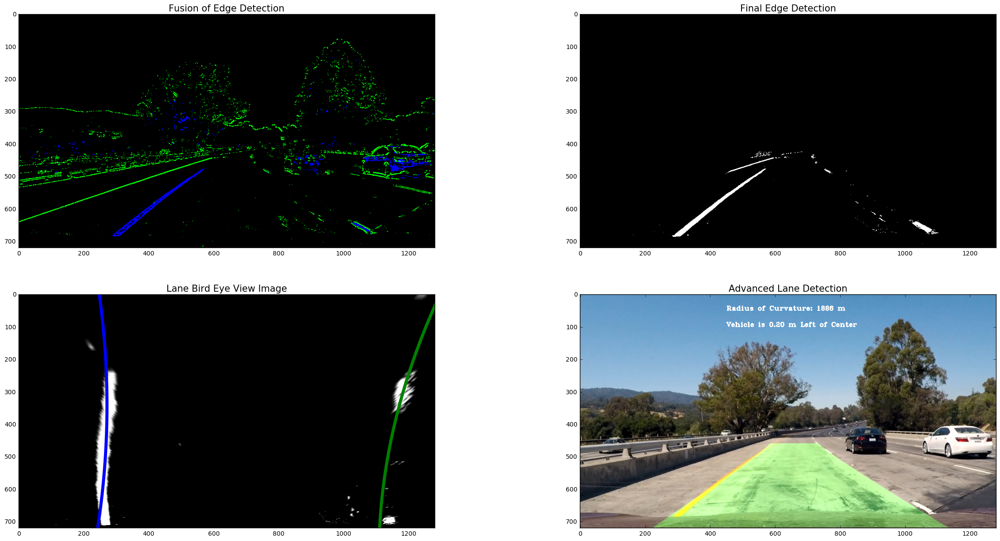

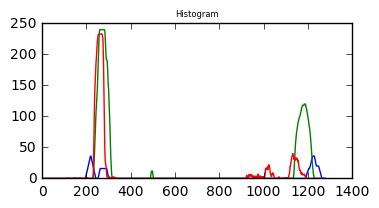

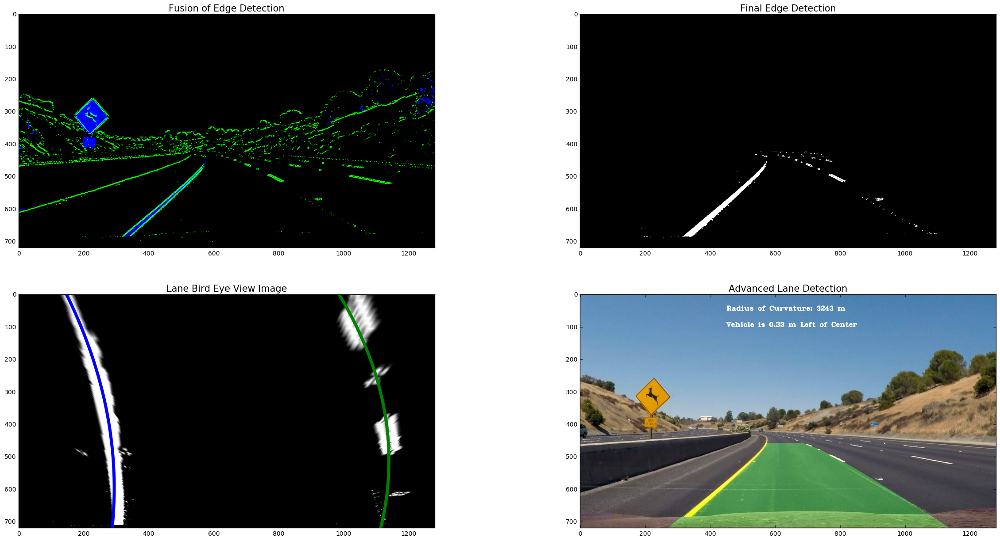

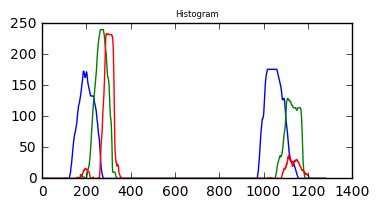

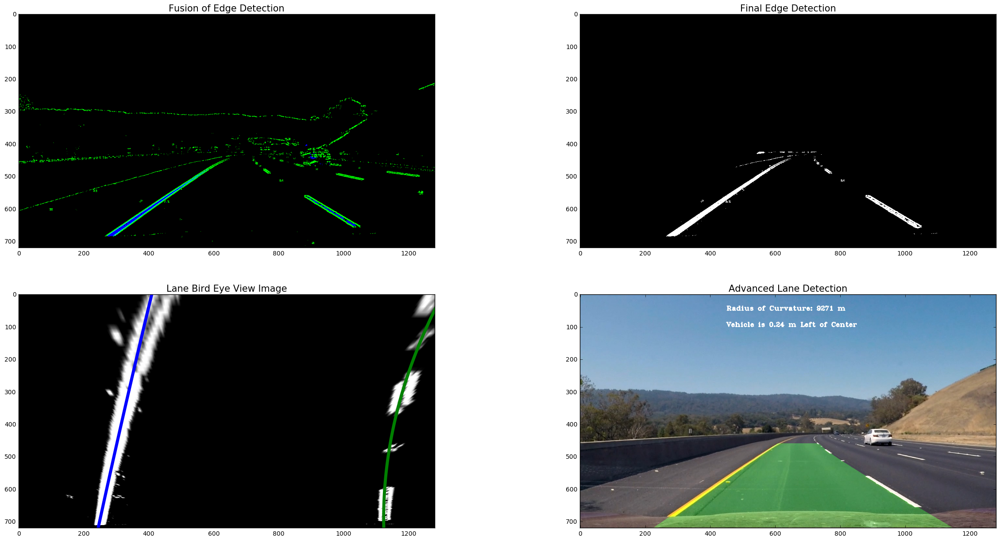

...

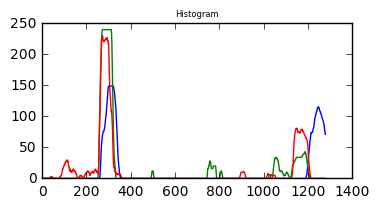

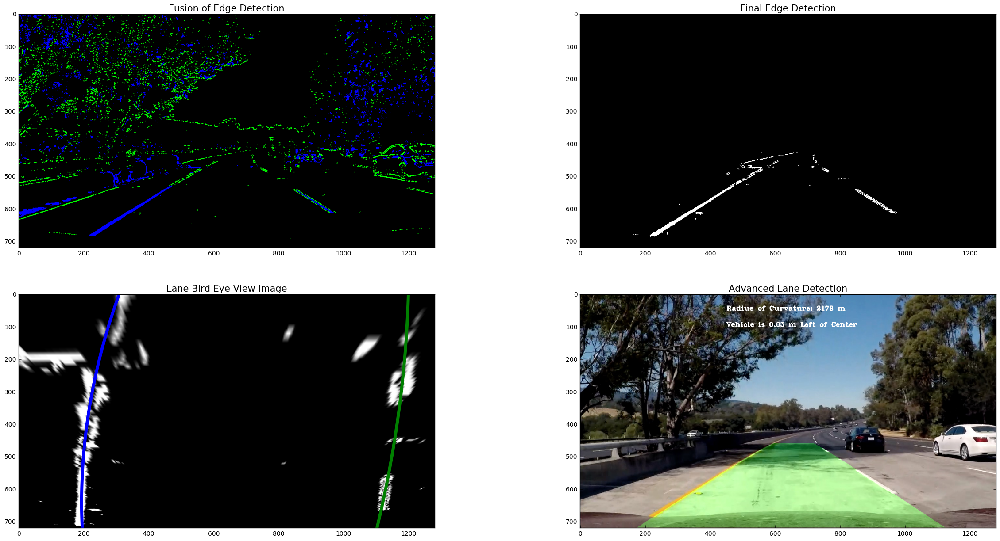

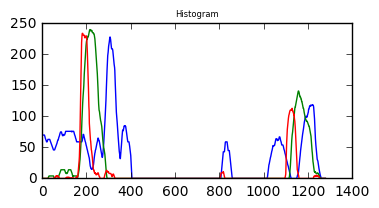

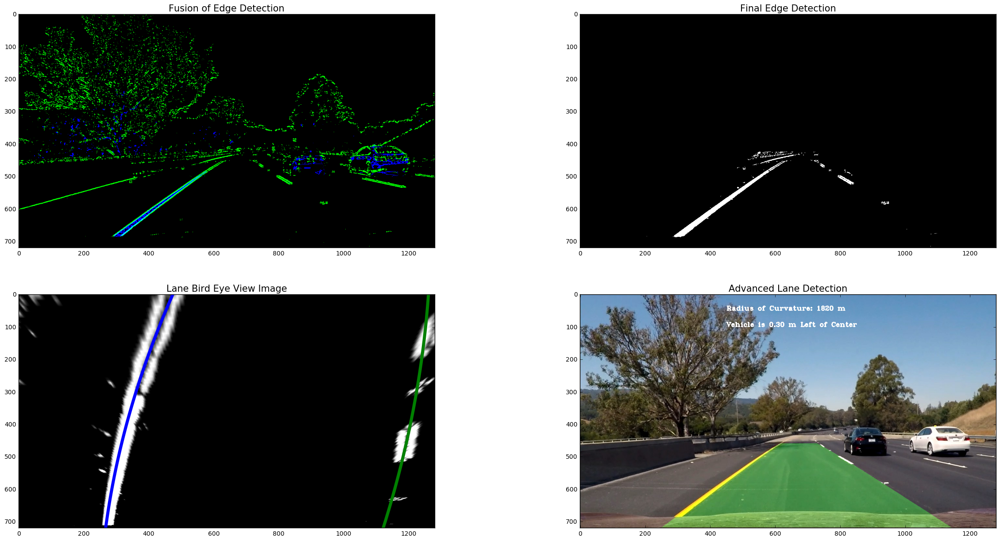

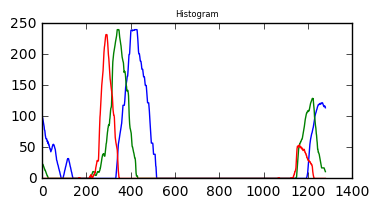

In [44]:
# RUN ADVANCED LANED TRACKING ON IMAGES
for i in range(1,7):
    # Initialize Objects for Left and Right Lines
    LeftLane=Line()
    RightLane=Line()
    
    # Load the Image
    Filename='Test-Images/test{}.jpg'.format(i)
    Image=plt.imread(Filename)
    
    # Process Image
    EdgeImage,StackBinary,BirdViewImg,LeftFitX,RightFitX,YVals,ImageColor=ProcessImage(Image)
    
    # Initialize Figure
    Figure,((Axis0,Axis1),(Axis2,Axis3))=plt.subplots(2,2,figsize=(30,15))
    
    # Display Fusion of Edge Detection
    Axis0.set_title('Fusion of Edge Detection',fontsize=15)
    Axis0.imshow(StackBinary,cmap='gray')
    
    # Display Edge Detection
    Axis1.set_title('Final Edge Detection',fontsize=15)
    Axis1.imshow(EdgeImage,cmap='gray')
    
    # Display Bird's Eye View
    Axis2.plot(LeftFitX,YVals,color='blue',linewidth=5)
    Axis2.plot(RightFitX,YVals,color='green',linewidth=5)
    Axis2.imshow(BirdViewImg,cmap='gray')
    Axis2.set_title('Lane Bird Eye View Image',fontsize=15)
    
    # Display Lane Detection
    Axis3.imshow(ImageColor)
    Axis3.set_title('Advanced Lane Detection',fontsize=15)
    
    # Plot Histograms
    Figure2,Axis4=plt.subplots(1,1,figsize=(4,2))
    BirdViewImg[BirdViewImg>0]=1
    Histogram=np.sum(BirdViewImg[:240,:],axis=0)
    Axis4.plot(Histogram)
    Histogram=np.sum(BirdViewImg[240:480,:],axis=0)
    Axis4.plot(Histogram)
    Histogram=np.sum(BirdViewImg[480:,:],axis=0)
    Axis4.plot(Histogram)
    Indexes=find_peaks_cwt(Histogram,np.arange(1,480))
    Axis4.set_title("Histogram",fontsize=6)
    
    # Save Results to File
    plt.imsave('Output-Images/FusionEdgeDetection{}.jpg'.format(i),StackBinary)
    plt.imsave('Output-Images/FinalEdgeDetection{}.jpg'.format(i),EdgeImage)
    plt.imsave('Output-Images/BirdEyeView{}.jpg'.format(i),BirdViewImg)
    plt.imsave('Output-Images/AdvancedLaneDetection{}.jpg'.format(i),ImageColor)

In [45]:
# DEFINE A FUNCTION TO PROCESS IMAGE
def ProcessVideoImage(Image):
    # Apply Pipeline to the Image to Create Binary Image
    EdgeImage,StackBinary,ROIImage=EdgeDetection(Image)
    
    # Transform the Image to Bird's Eye View
    BirdViewImg,WarpMat,WarpMatInv,VerticesOriginal,RoadVerticesBirdEyeView=BirdEyeView(EdgeImage,
                                                                                        CameraMat,DistCoeffs)
    
    # Find the Lines Fitting to Left and Right Lanes
    YVals,LeftFitX,RightFitX,LeftLaneX,LeftLaneY,RightLaneX,RightLaneY,LeftCurveRad,RightCurveRad\
    =LaneDetection(BirdViewImg)
    
    # Draw
    ImageColor=DrawPolyLine(Image,BirdViewImg,
                            YVals,LeftFitX,RightFitX,LeftLaneX,LeftLaneY,RightLaneX,RightLaneY,
                            WarpMatInv,LeftCurveRad) 
    
    # Return Final Processed Image
    return ImageColor

#### Advanced Lane Detection for Video

In [46]:
# RUN ADVANCED LANED TRACKING ON VIDEO
# Import Modules
from moviepy.editor import VideoFileClip
from IPython.display import HTML

# Initialize Objects for Left and Right Lines
LeftLane=Line()
RightLane=Line()

# Initialize Video and Save Processed Images
VideoFile='Videos/Output.mp4'
Clip=VideoFileClip('Videos/project_video.mp4')
Video=Clip.fl_image(ProcessVideoImage) 
%time Video.write_videofile(VideoFile,audio=False)

[MoviePy] >>>> Building video Videos/Output.mp4
[MoviePy] Writing video Videos/Output.mp4


100%|█████████▉| 1260/1261 [07:19<00:00,  2.93it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: Videos/Output.mp4 

CPU times: user 38min 22s, sys: 10.6 s, total: 38min 33s
Wall time: 7min 19s


In [48]:
# RUN ADVANCED LANED TRACKING ON VIDEO (CHALLENGE)
# Import Modules
from moviepy.editor import VideoFileClip
from IPython.display import HTML

# Initialize Objects for Left and Right Lines
LeftLane=Line()
RightLane=Line()

# Initialize Video and Save Processed Images
VideoFile='Videos/Challenge_Output.mp4'
Clip=VideoFileClip('Videos/challenge_video.mp4')
Video=Clip.fl_image(ProcessVideoImage) 
%time Video.write_videofile(VideoFile,audio=False)

[MoviePy] >>>> Building video Videos/Challenge_Output.mp4
[MoviePy] Writing video Videos/Challenge_Output.mp4



  3%|▎         | 15/485 [00:05<02:47,  2.80it/s]

KeyboardInterrupt: 

In [ ]:
# RUN ADVANCED LANED TRACKING ON VIDEO (HARDER CHALLENGE)
# Import Modules
from moviepy.editor import VideoFileClip
from IPython.display import HTML

# Initialize Objects for Left and Right Lines
LeftLane=Line()
RightLane=Line()

# Initialize Video and Save Processed Images
VideoFile='Videos/Harder_Challenge_Output.mp4'
Clip=VideoFileClip('Videos/harder_challenge_video.mp4')
Video=Clip.fl_image(ProcessVideoImage)
%time Video.write_videofile(VideoFile,audio=False)